In [1]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
from glob import glob
from keras import preprocessing

In [2]:
%matplotlib inline

In [3]:
class_names = ['CUP', 'SPOON', 'FORK', 'MOUSE']

In [4]:
CAMERA = cv2.VideoCapture(0)
camera_height = 500

In [5]:
raw_frames_type_1 = []
raw_frames_type_3 = []
raw_frames_type_2 = []
raw_frames_type_4 = []

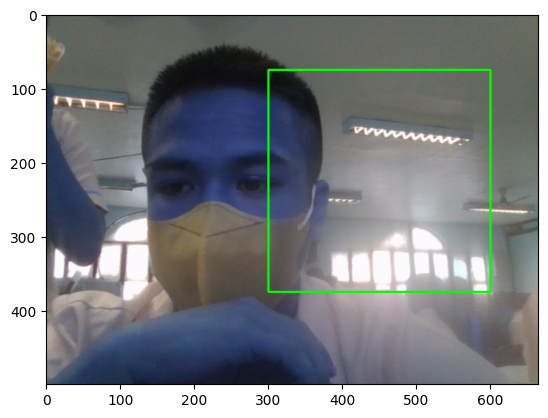

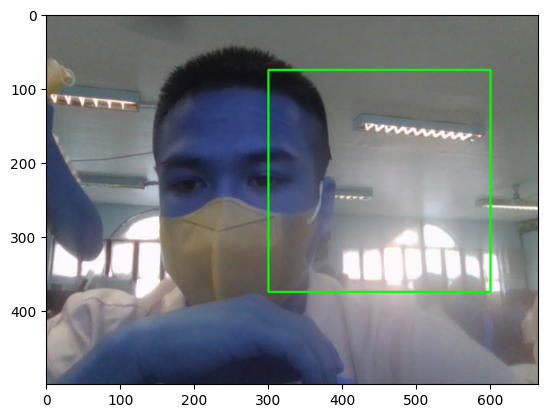

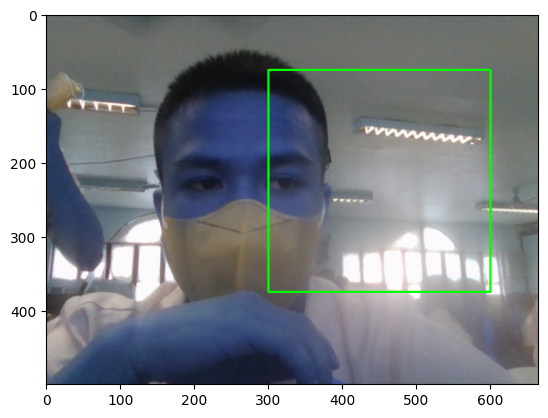

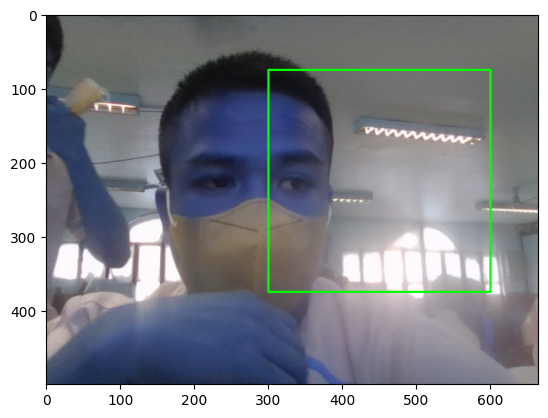

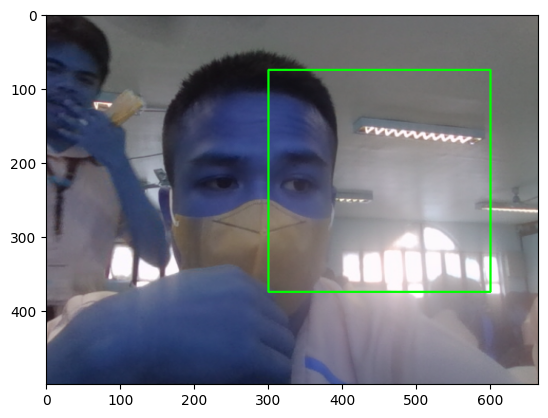

...

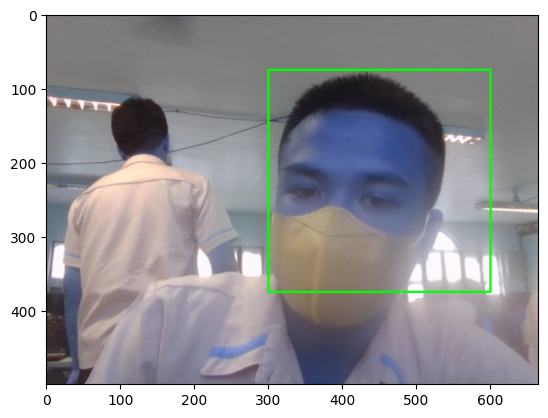

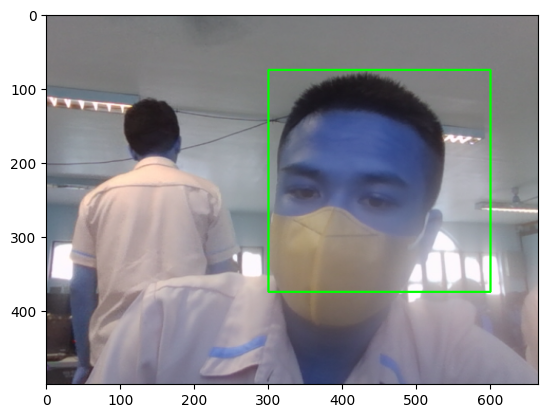

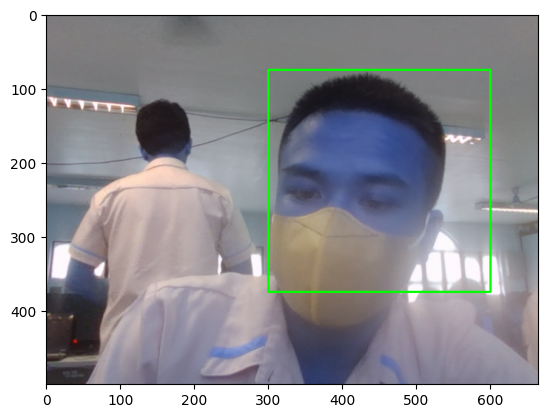

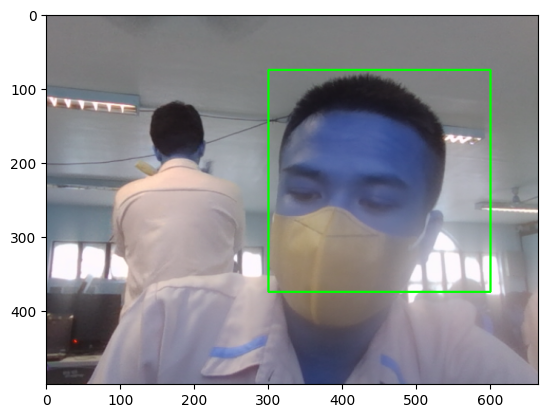

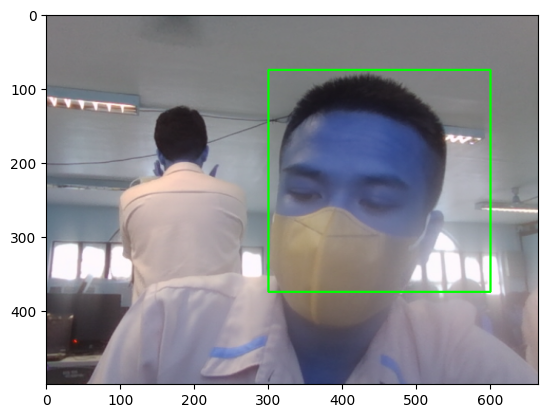

In [6]:
while CAMERA.isOpened():
    #Read new camera frame

    ret, frame = CAMERA.read()

    #Flip the frame horizontally (to get a mirror image)
    frame = cv2.flip(frame, 1)

    #Rescale the image output
    aspect = frame.shape[1] / float(frame.shape[0])
    res = int(aspect * camera_height) #landscape orientation - wide image
    frame = cv2.resize(frame, (res, camera_height))

    #The green rectable
    cv2.rectangle(frame, (300, 75), (600, 375), (0, 255, 0), 2)

    #Show the frame
    cv2.imshow('Capturing...', frame)

    #Controls q = quit  / s = capturing
    key = cv2.waitKey(1)

    if key & 0xFF == ord('q'):
        break
    elif key & 0xFF == ord('1'):
        raw_frames_type_1.append(frame)
    elif key & 0xFF == ord('2'):
        raw_frames_type_2.append(frame)
    elif key & 0xFF == ord('3'):
        raw_frames_type_3.append(frame)
    elif key & 0xFF == ord('4'):
        raw_frames_type_4.append(frame)

    plt.imshow(frame)
    plt.show()
    
# When everything done, release the capture
CAMERA.release()
cv2.destroyAllWindows()


In [7]:
save_width = 224
save_height = 224

In [8]:
retval = os.getcwd()
print('Current working directory: %s', retval)

Current working directory: %s d:\CURRENTLY WORKING ON\CCS221 - Image Segmentation\ImgSegmetation


In [9]:
#Printing the dataset
print('Printing the dataset')
print('Type 1: ', len(raw_frames_type1))
print('Type 2: ', len(raw_frames_type2))
print('Type 3: ', len(raw_frames_type3))
print('Type 4: ', len(raw_frames_type4))

Printing the dataset


NameError: name 'raw_frames_type1' is not defined

In [ ]:
#Crop the images
for i, frame in enumerate(raw_frames_type_1):

    #Get roi
    roi = frame[75+2:425-2, 300+2:650-2]

    #Parse BRG to RGB
    roi = cv2.cvtColor(roi, cv2.COLOR_BGR2RGB)

    #Resize
    roi = cv2.resize(roi, (save_width, save_height))

    #Save
    cv2.imwrite('img_1/{}.png'.format(i), cv2.cvtColor(roi, cv2.COLOR_RGB2BGR))



In [ ]:
#Crop the images

for i, frame in enumerate(raw_frames_type_2):

    #Get roi
    roi = frame[75+2:425-2, 300+2:650-2]

    #Parse BRG to RGB
    roi = cv2.cvtColor(roi, cv2.COLOR_BGR2RGB)

    #Resize
    roi = cv2.resize(roi, (save_width, save_height))

    #Save
    cv2.imwrite('img_2/{}.png'.format(i), cv2.cvtColor(roi, cv2.COLOR_RGB2BGR))



In [ ]:
#Crop the images

for i, frame in enumerate(raw_frames_type_3):

    #Get roi
    roi = frame[75+2:425-2, 300+2:650-2]

    #Parse BRG to RGB
    roi = cv2.cvtColor(roi, cv2.COLOR_BGR2RGB)

    #Resize
    roi = cv2.resize(roi, (save_width, save_height))

    #Save
    cv2.imwrite('img_3/{}.png'.format(i), cv2.cvtColor(roi, cv2.COLOR_RGB2BGR))


In [ ]:
#Crop the images

for i, frame in enumerate(raw_frames_type_4):

    #Get roi
    roi = frame[75+2:425-2, 300+2:650-2]

    #Parse BRG to RGB
    roi = cv2.cvtColor(roi, cv2.COLOR_BGR2RGB)

    #Resize
    roi = cv2.resize(roi, (save_width, save_height))

    #Save
    cv2.imwrite('img_4/{}.png'.format(i), cv2.cvtColor(roi, cv2.COLOR_RGB2BGR))



In [ ]:
width = 96
height = 96

images_type_1 = []
images_type_2 = []
images_type_3 = []
images_type_4 = []

In [ ]:
for images_path in glob('img_1/*.*'):
    image = preprocessing.image.load_img(images_path, target_size=(width, height))
    x = preprocessing.image.img_to_array(image)

    images_type_1.append(x)

for images_path in glob('img_2/*.*'):
    image = preprocessing.image.load_img(images_path, target_size=(width, height))
    x = preprocessing.image.img_to_array(image)

    images_type_2.append(x)

for images_path in glob('img_3/*.*'):
    image = preprocessing.image.load_img(images_path, target_size=(width, height))
    x = preprocessing.image.img_to_array(image)

    images_type_3.append(x)

for images_path in glob('img_4/*.*'):
    image = preprocessing.image.load_img(images_path, target_size=(width, height))
    x = preprocessing.image.img_to_array(image)

    images_type_4.append(x)


In [ ]:
plt.figure(figsize=(12, 8))

for i, x in enumerate(images_type_1[:5]):
    plt.subplot(1, 5, i+1)
    image = preprocessing.image.array_to_img(x)
    plt.imshow(image)
    plt.axis('off')
    plt.title('{} image'.format(class_names[0]))

plt.show()



In [ ]:
plt.figure(figsize=(12, 8))

for i, x in enumerate(images_type_2[:5]):
    plt.subplot(1, 5, i+1)
    image = preprocessing.image.array_to_img(x)
    plt.imshow(image)
    plt.axis('off')
    plt.title('{} image'.format(class_names[1]))

plt.show()


In [ ]:
plt.figure(figsize=(12, 8))

for i, x in enumerate(images_type_3[:5]):
    plt.subplot(1, 5, i+1)
    image = preprocessing.image.array_to_img(x)
    plt.imshow(image)
    plt.axis('off')
    plt.title('{} image'.format(class_names[2]))

plt.show()


In [ ]:
plt.figure(figsize=(12, 8))

for i, x in enumerate(images_type_4[:5]):
    plt.subplot(1, 5, i+1)
    image = preprocessing.image.array_to_img(x)
    plt.imshow(image)
    plt.axis('off')
    plt.title('{} image'.format(class_names[3]))

plt.show()